<a href="https://colab.research.google.com/github/nilaycicekli/internship/blob/main/yolo_with_coco.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## install dependencies

In [ ]:
# clone Scaled_YOLOv4
!git clone https://github.com/roboflow-ai/ScaledYOLOv4.git  # clone repo
%cd /content/ScaledYOLOv4/
#checkout the yolov4-large branch
!git checkout yolov4-large

fatal: destination path 'ScaledYOLOv4' already exists and is not an empty directory.
/content/ScaledYOLOv4
Already on 'yolov4-large'
Your branch is up to date with 'origin/yolov4-large'.


In [ ]:
import torch
print('Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Using torch 1.8.1+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


In [ ]:
#install mish activation funciton for cuda
%cd /content/ScaledYOLOv4
!git clone https://github.com/JunnYu/mish-cuda
%cd mish-cuda
!python setup.py build install

/content/ScaledYOLOv4
Cloning into 'mish-cuda'...
remote: Enumerating objects: 195, done.
remote: Counting objects: 100% (88/88), done.
remote: Compressing objects: 100% (75/75), done.
remote: Total 195 (delta 7), reused 79 (delta 3), pack-reused 107
Receiving objects: 100% (195/195), 208.77 KiB | 9.94 MiB/s, done.
Resolving deltas: 100% (56/56), done.
/content/ScaledYOLOv4/mish-cuda
/usr/lib/python3.7/distutils/extension.py:131: UserWarning: Unknown Extension options: 'headers'
  warnings.warn(msg)
running build
running build_py
creating build
creating build/lib.linux-x86_64-3.7
creating build/lib.linux-x86_64-3.7/mish_cuda
copying src/mish_cuda/__init__.py -> build/lib.linux-x86_64-3.7/mish_cuda
running egg_info
creating src/mish_cuda.egg-info
writing src/mish_cuda.egg-info/PKG-INFO
writing dependency_links to src/mish_cuda.egg-info/dependency_links.txt
writing requirements to src/mish_cuda.egg-info/requires.txt
writing top-level names to src/mish_cuda.egg-info/top_level.txt
writing 

In [ ]:
#%cd /content/ScaledYOLOv4/mish-cuda/build/lib.linux-x86_64-3.7/mish_cuda
%cd /content/ScaledYOLOv4/mish-cuda/build/lib.linux-x86_64-3.7/mish_cuda
%ls

/content/ScaledYOLOv4/mish-cuda/build/lib.linux-x86_64-3.7/mish_cuda
_C.cpython-37m-x86_64-linux-gnu.so*  __init__.py


In [ ]:
%cp _C.cpython-37m-x86_64-linux-gnu.so /usr/local/lib/python3.7/dist-packages/mish_cuda

In [ ]:
!pip install -U PyYAML

     |████████████████████████████████| 645kB 8.4MB/s 
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
%cd /content/ScaledYOLOv4/

/content/ScaledYOLOv4


## Download Correctly Formatted Custom Dataset

We'll download our dataset from Roboflow. Use the "YOLOv5 PyTorch" export format. Note that the Ultralytics implementation calls for a YAML file defining where your training and test data is. The Roboflow export also writes this format for us.

In [ ]:
# Export code snippet and paste here
%cd /content
!curl -L "https://public.roboflow.com/ds/6Gyj8KYccl?key=wHPGWx3Qnk" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   895  100   895    0     0   1532      0 --:--:-- --:--:-- --:--:--  1529
100 19.2M  100 19.2M    0     0  15.0M      0  0:00:01  0:00:01 --:--:-- 15.0M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/00dea1edf14f09ab_jpg.rf.e88c0cbf2d2fa49acf7710d4962b3835.jpg  
 extracting: test/images/00e481ea1a520175_jpg.rf.49a7562e0ada29cc96e9da3321c96b70.jpg  
 extracting: test/images/08c8b73e0c2e296e_jpg.rf.24496f1095ffd45262fd1f9d9865e94a.jpg  
 extracting: test/images/10c26c6598677a1f_jpg.rf.ee3114415966e1cb8cbf10064b4607ff.jpg  
 extracting: test/images/1ef77c61856d3b4b_jpg.rf.76fa06bea222a369099ae15217c75cd9.jpg  
 extracting: test/images/259ff749ac781352_jpg.rf.0f5c

In [ ]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 5
names: ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']

## Inspect Model Configuration and Architecture
Let's look at the Scaled-YOLOv4 Configuration architecture

In [ ]:
%cat /content/ScaledYOLOv4/models/yolov4-csp.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 1.0  # model depth multiple
width_multiple: 1.0  # layer channel multiple

# anchors
anchors:
  - [12,16, 19,36, 40,28]  # P3/8
  - [36,75, 76,55, 72,146]  # P4/16
  - [142,110, 192,243, 459,401]  # P5/32

# yolov4-csp backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [32, 3, 1]],  # 0
   [-1, 1, Conv, [64, 3, 2]],  # 1-P1/2
   [-1, 1, Bottleneck, [64]],
   [-1, 1, Conv, [128, 3, 2]],  # 3-P2/4
   [-1, 2, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 5-P3/8
   [-1, 8, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 7-P4/16
   [-1, 8, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]], # 9-P5/32
   [-1, 4, BottleneckCSP, [1024]],  # 10
  ]

# yolov4-csp head
# na = len(anchors[0])
head:
  [[-1, 1, SPPCSP, [512]], # 11
   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [8, 1, Conv, [256, 1, 1]], # route backbone P4
   [[-1, -2], 1, Concat, [1]],
   [-1, 2, Bott

# Train Custom Scaled-YOLOv4 Detector

### Next, we'll fire off training!


Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights.
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [ ]:
# train scaled-YOLOv4 on custom data for 100 epochs
# time its performance
%%time
%cd /content/ScaledYOLOv4/
!python train.py --img 416 --batch 16 --epochs 100 --data '../data.yaml' --cfg ./models/yolov4-csp.yaml --weights '' --name yolov4-csp-results  --cache

/content/ScaledYOLOv4
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/yolov4-csp.yaml', data='../data.yaml', device='', epochs=100, evolve=False, global_rank=-1, hyp='data/hyp.scratch.yaml', img_size=[416, 416], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov4-csp-results', noautoanchor=False, nosave=False, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=16, weights='', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2021-04-26 12:50:32.371012: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Hyperparameters {'lr0': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma': 0.0, 'hsv_h': 0.015, 'hsv_s':

In [ ]:
!ls

data	   inference  __pycache__  runs     train.py
detect.py  models     README.md    test.py  utils


## Evaluate Custom Scaled-YOLOv4 Detector Performance

Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the --name flag when we train. In our case, we named this yolov5s_results. (If given no name, it defaults to results.txt.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed results.txt files can be plotted with from utils.utils import plot_results; plot_results().



In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

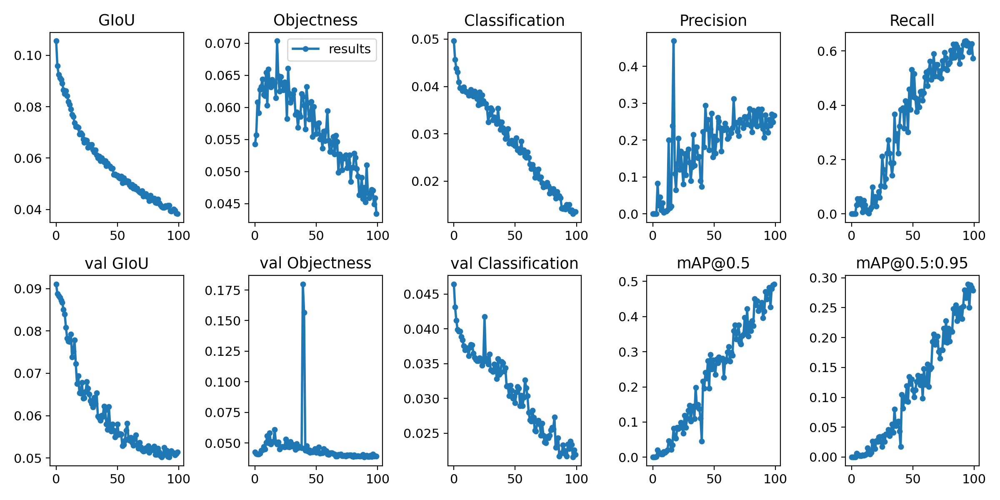

In [ ]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
#from utils.general import plot_results  # plot results.txt as results.png
from IPython.display import Image, display
display(Image('/content/ScaledYOLOv4/runs/exp0_yolov4-csp-results/results.png'))  # view results.png

### Curious? Visualize Our Training Data with Labels

After training starts, view `train*.jpg` images to see training images, labels and augmentation effects.

Note a mosaic dataloader is used for training (shown below), a new dataloading concept developed by Glenn Jocher and first featured in [YOLOv4](https://arxiv.org/abs/2004.10934).

GROUND TRUTH TRAINING DATA:


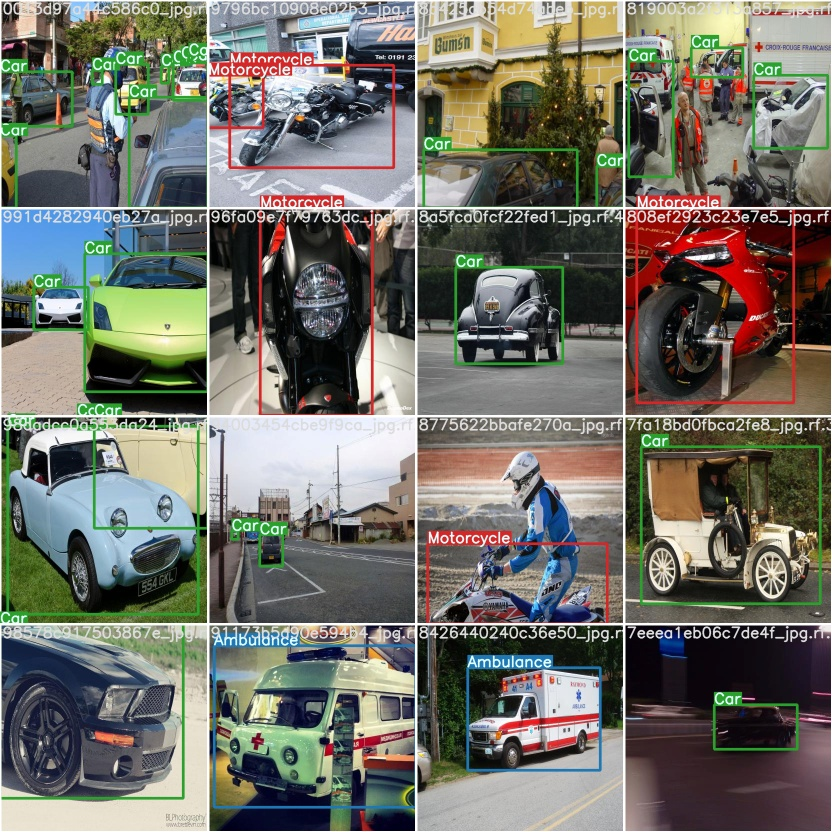

In [ ]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/ScaledYOLOv4/runs/exp0_yolov4-csp-results/test_batch0_gt.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


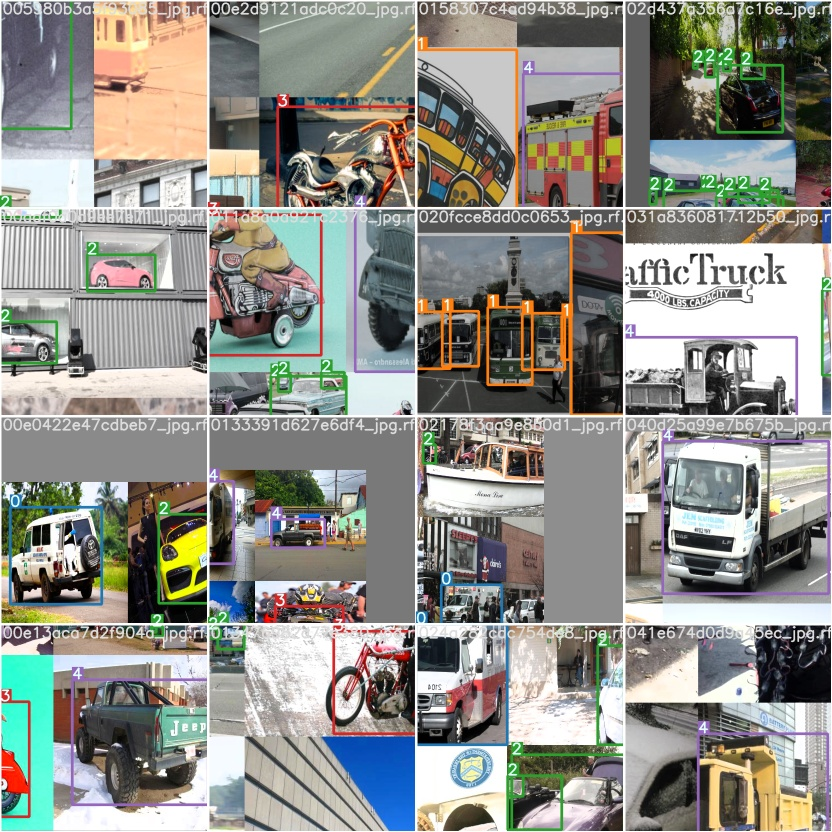

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/ScaledYOLOv4/runs/exp0_yolov4-csp-results/train_batch0.jpg', width=900)

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [ ]:
# trained weights are saved by default in our weights folder
%ls runs/

exp0_yolov4-csp-results/


In [ ]:
%ls ./runs/exp0_yolov4-csp-results/weights

best_yolov4-csp-results.pt        last_080.pt  last_092.pt
best_yolov4-csp-results_strip.pt  last_081.pt  last_093.pt
last_070.pt                       last_082.pt  last_094.pt
last_071.pt                       last_083.pt  last_095.pt
last_072.pt                       last_084.pt  last_096.pt
last_073.pt                       last_085.pt  last_097.pt
last_074.pt                       last_086.pt  last_098.pt
last_075.pt                       last_087.pt  last_099.pt
last_076.pt                       last_088.pt  last_yolov4-csp-results.pt
last_077.pt                       last_089.pt  last_yolov4-csp-results_strip.pt
last_078.pt                       last_090.pt
last_079.pt                       last_091.pt


In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/ScaledYOLOv4/
!python detect.py --weights ./runs/exp0_yolov4-csp-results/weights/best_yolov4-csp-results.pt --img 416 --conf 0.4 --source ../test/images

/content/ScaledYOLOv4
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='../test/images', update=False, view_img=False, weights=['./runs/exp0_yolov4-csp-results/weights/best_yolov4-csp-results.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Fusing layers... Model Summary: 235 layers, 5.24921e+07 parameters, 5.04494e+07 gradients
image 1/63 /content/test/images/00dea1edf14f09ab_jpg.rf.e88c0cbf2d2fa49acf7710d4962b3835.jpg: 416x416 1 Ambulances, Done. (0.026s)
image 2/63 /content/test/images/00e481ea1a520175_jpg.rf.49a7562e0ada29cc96e9da3321c96b70.jpg: 416x416 1 Buss, Done. (0.026s)
image 3/63 /content/test/images/08c8b73e0c2e296e_jpg.rf.24496f1095ffd45262fd1f9d9865e94a.jpg: 416x416 2 Buss, Done. (0.026s)
image 4/63 /content/test/images/10c26c6598677a1f_jpg.rf.ee3114415966e1cb8cbf10064b4607ff.jpg: 416x416 Done. (0.020s)
image 5/63 /conte

In [ ]:
%cd /content/ScaledYOLOv4/
!python detect.py --weights ../best_yolov4-csp-results.pt --img 416 --conf 0.4 --source ../test/images

In [ ]:
%cd /content/ScaledYOLOv4
!python detect.py --weights ../best_yolov4-csp-results.pt --img 416 --conf 0.4 --source ../test/images

/content/ScaledYOLOv4
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='../test/images', update=False, view_img=False, weights=['../best_yolov4-csp-results.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Fusing layers... Model Summary: 235 layers, 5.24921e+07 parameters, 5.04494e+07 gradients
image 1/63 /content/test/images/00dea1edf14f09ab_jpg.rf.e88c0cbf2d2fa49acf7710d4962b3835.jpg: 416x416 1 Ambulances, Done. (0.032s)
image 2/63 /content/test/images/00e481ea1a520175_jpg.rf.49a7562e0ada29cc96e9da3321c96b70.jpg: 416x416 1 Buss, Done. (0.026s)
image 3/63 /content/test/images/08c8b73e0c2e296e_jpg.rf.24496f1095ffd45262fd1f9d9865e94a.jpg: 416x416 2 Buss, Done. (0.026s)
image 4/63 /content/test/images/10c26c6598677a1f_jpg.rf.ee3114415966e1cb8cbf10064b4607ff.jpg: 416x416 Done. (0.025s)
image 5/63 /content/test/images/1ef77c61856d3b4b_jpg.

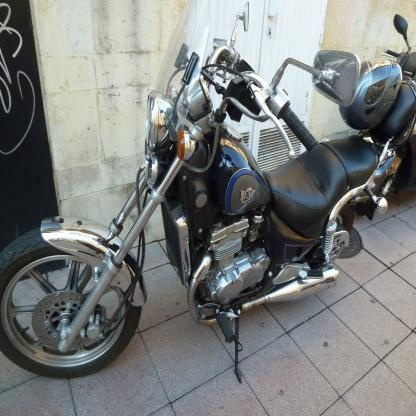

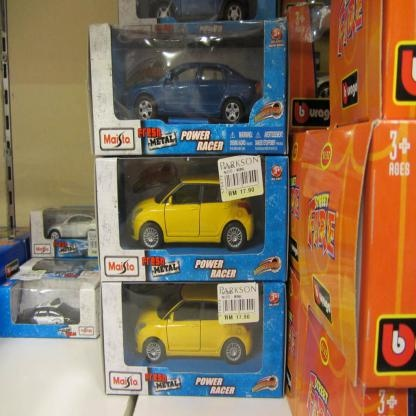

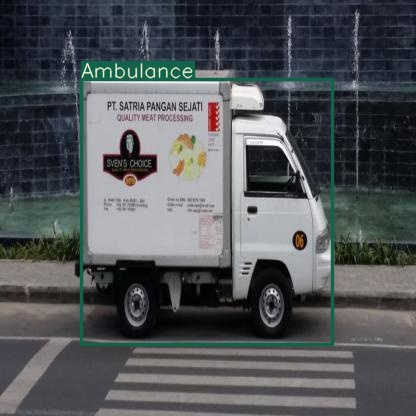

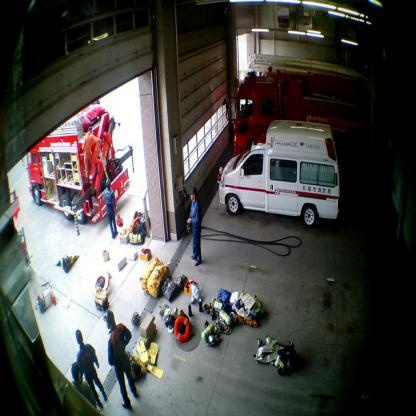

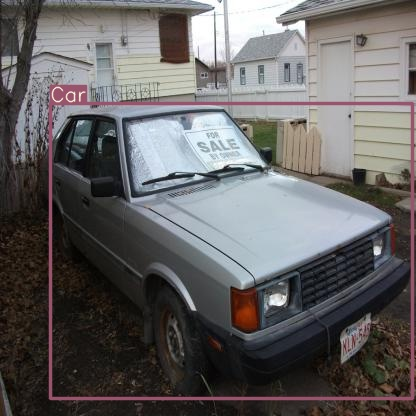

...

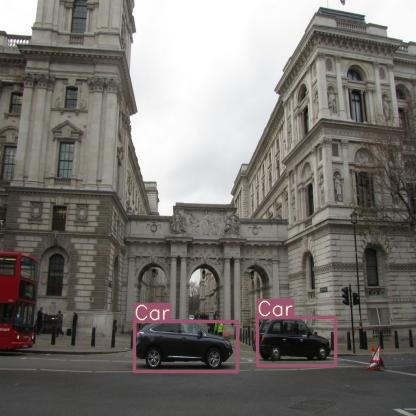

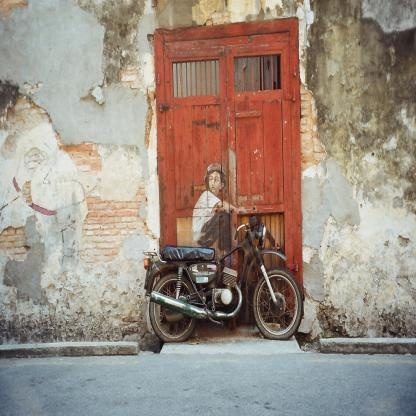

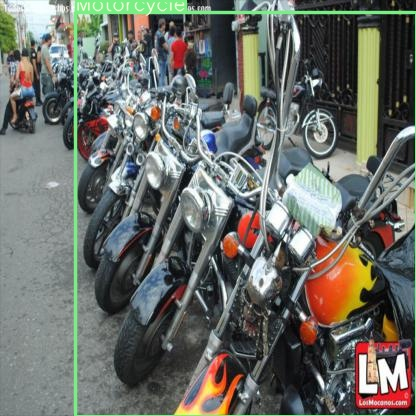

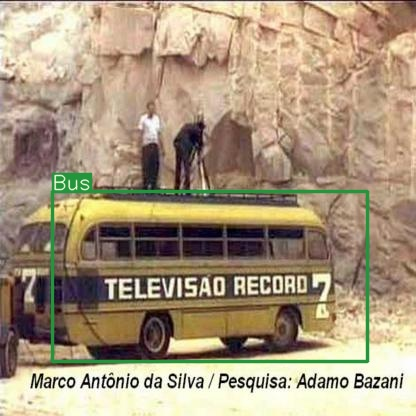

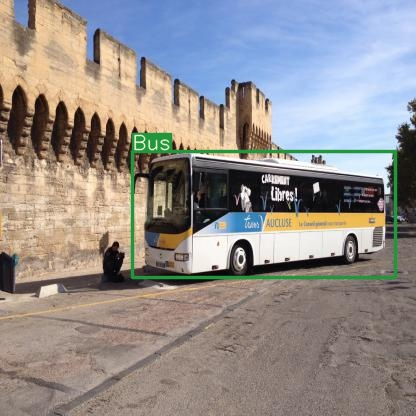

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above
import glob
from IPython.display import Image, display

for imageName in glob.glob('./inference/output/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Export Trained Weights for Future Inference

Now that you have trained your custom detector, you can export the trained weights you have made here for inference on your device elsewhere

In [ ]:
from google.colab import files
files.download('./runs/exp0_yolov4-csp-results/weights/best_yolov4-csp-results.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
%ls /content/ScaledYOLOv4/models
#!python train.py --img 416 --batch 16 --epochs 100 --data '../data.yaml' --cfg ./models/yolov4-csp.yaml --weights '' --name yolov4-csp-results  --cache

common.py        export.py    __pycache__/  yolov4-csp.yaml  yolov4-p6.yaml
experimental.py  __init__.py  yolo.py       yolov4-p5.yaml   yolov4-p7.yaml


In [ ]:
%cd /content
path = '/content/ScaledYOLOv4/'
weights = '/content/ScaledYOLOv4/runs/exp0_yolov4-csp-results/weights/best_yolov4-csp-results.pt'
#model = torch.hub.load('ultralytics/yolov5','custom', path_or_model='/content/best.pt')
#model = torch.hub.load(source='local', repo_or_dir='/content/ScaledYOLOv4/ultralytics_yolov5_master', model='custom', path_or_model=trained_model)
model = torch.hub.load(repo_or_dir='ultralytics/yolov5', model='custom', path_or_model=trained_model)

/content
requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...


Using cache found in /content/ScaledYOLOv4/ultralytics_yolov5_master



requirements: 1 package updated per /content/ScaledYOLOv4/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



AttributeError: ignored

In [ ]:
!pip install -U PyYAML

Requirement already up-to-date: PyYAML in /usr/local/lib/python3.7/dist-packages (5.4.1)


In [ ]:
#install mish activation funciton for cuda
%cd /content/
!git clone https://github.com/JunnYu/mish-cuda
%cd mish_cuda
!python setup.py build install

/content
fatal: destination path 'mish-cuda' already exists and is not an empty directory.
[Errno 2] No such file or directory: 'mish_cuda'
/content
python3: can't open file 'setup.py': [Errno 2] No such file or directory


In [ ]:
map_location=torch.device('cpu')
torch.load('tensors.pt', map_location=lambda storage, loc: storage.cuda(1))
# Map tensors from GPU 1 to GPU 0
    >>> torch.load('tensors.pt', map_location={'cuda:1':'cuda:0'})

In [ ]:
%pwd

'/content'

In [ ]:
import torch
model = torch.load('../best_yolov4-csp-results.pt')

In [ ]:
type(model)

dict

In [ ]:
%rm -r /content/ScaledYOLOv4/mish-cuda

In [ ]:
#install mish activation funciton for cuda
%cd /content/ScaledYOLOv4/
!git clone https://github.com/thomasbrandon/mish-cuda
%cd mish-cuda
!python setup.py build install

In [ ]:
pip install git+https://github.com/thomasbrandon/mish-cuda/

  Cloning https://github.com/thomasbrandon/mish-cuda/ to /tmp/pip-req-build-7kx7zjh9
  Running command git clone -q https://github.com/thomasbrandon/mish-cuda/ /tmp/pip-req-build-7kx7zjh9
  Created wheel for mish-cuda: filename=mish_cuda-0.0.3-cp37-cp37m-linux_x86_64.whl size=2839098 sha256=8b89fcb70bb61f3e37f673158bcd8717609613c571dba4e76fea3edd3efb25eb
  Stored in directory: /tmp/pip-ephem-wheel-cache-52ukbgc9/wheels/96/54/8b/499e8045b28fc7c486566e29fdd6f417347a887e1009718131
Successfully built mish-cuda


In [ ]:
# PyTorch Hub
%cd /content
import torch

# Model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')

# Images
dir = 'https://github.com/ultralytics/yolov5/raw/master/data/images/'
imgs = [dir + f for f in ('zidane.jpg', 'bus.jpg')]  # batch of images

# Inference
results = model(imgs)
results.print()  # or .show(), .save()

/content


Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master


ImportError: ignored